<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

# Data Loading and DataFrame/DataSeries Generation

We're going to load all the image data into an xarray data series object.  We'll also do some image manipulation to make sure everything is the same size (via downsampling), and we'll try to grab some metadata out of the DICOM info.  This might get trickier as future data may be 

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import SimpleITK as sitk
import sys, os
import numpy as np
from scipy import ndimage as ndi
import skimage as skim
from skimage import feature
import pandas as pd
import xarray as xr
plt.rcParams['figure.figsize'] = (10,8)
import os
import pickle as pkl
from skimage import morphology
import joypy
%load_ext autoreload
%autoreload 2

from mre.plotting import grid_plots

In [2]:
full_data_dir = '/pghbio/dbmi/batmanlab/bpollack/predictElasticity/data/MRE/'
subjects = sorted([x for x in os.listdir(full_data_dir) if x.isdigit()])
subdir_names = ['SE00001','SE00002','SE00003','SE00004','SE00005','SE00006']
sequence_labels = ['T2SS', 'T1Pre', 'T1Pos', 'T2FR', 'elastMsk', 'elast']
extras = ['extra0', 'extra1', 'extra2', 'extra3']

In [3]:
ds = pkl.load(open(full_data_dir+'mre_ds_preprocess_3.p', 'rb'))

In [4]:
ds

<xarray.Dataset>
Dimensions:      (sequence: 10, subject: 50, x: 256, y: 256, z: 4)
Coordinates:
  * subject      (subject) <U3 '148' '162' '163' '178' ... '404' '405' '406'
  * sequence     (sequence) <U8 'T1Pre' 'T1Pos' 'T2FR' ... 'extra2' 'extra3'
Dimensions without coordinates: x, y, z
Data variables:
    image        (subject, sequence, z, y, x) float32 0.0 0.0 0.0 ... 0.0 0.0
    age          (subject) int8 -59 -27 -91 -107 117 ... -107 -107 5 -59 101
    z_space      (subject, sequence) float16 13.8 10.0 10.0 10.0 ... 0.0 0.0 0.0
    z_space_std  (subject) float16 1.684 1.684 3.826 1.2 ... 3.812 1.049 2.854

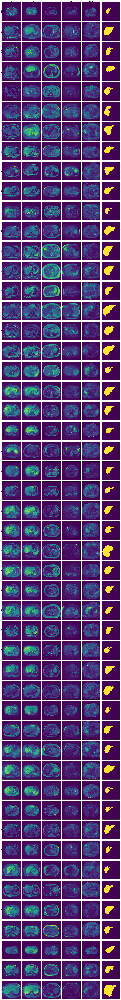

In [5]:
good_seq = ['T1Pre', 'T1Pos', 'T2SS', 'T2FR', 'elast', 'liverMsk']

ds_tmp = ds.sel(sequence=good_seq, z=0)
#ds_tmp = ds.sel(sequence=good_seq, z=0, )
fig, axs = grid_plots(ds_tmp, 'subject', 'sequence', title='')

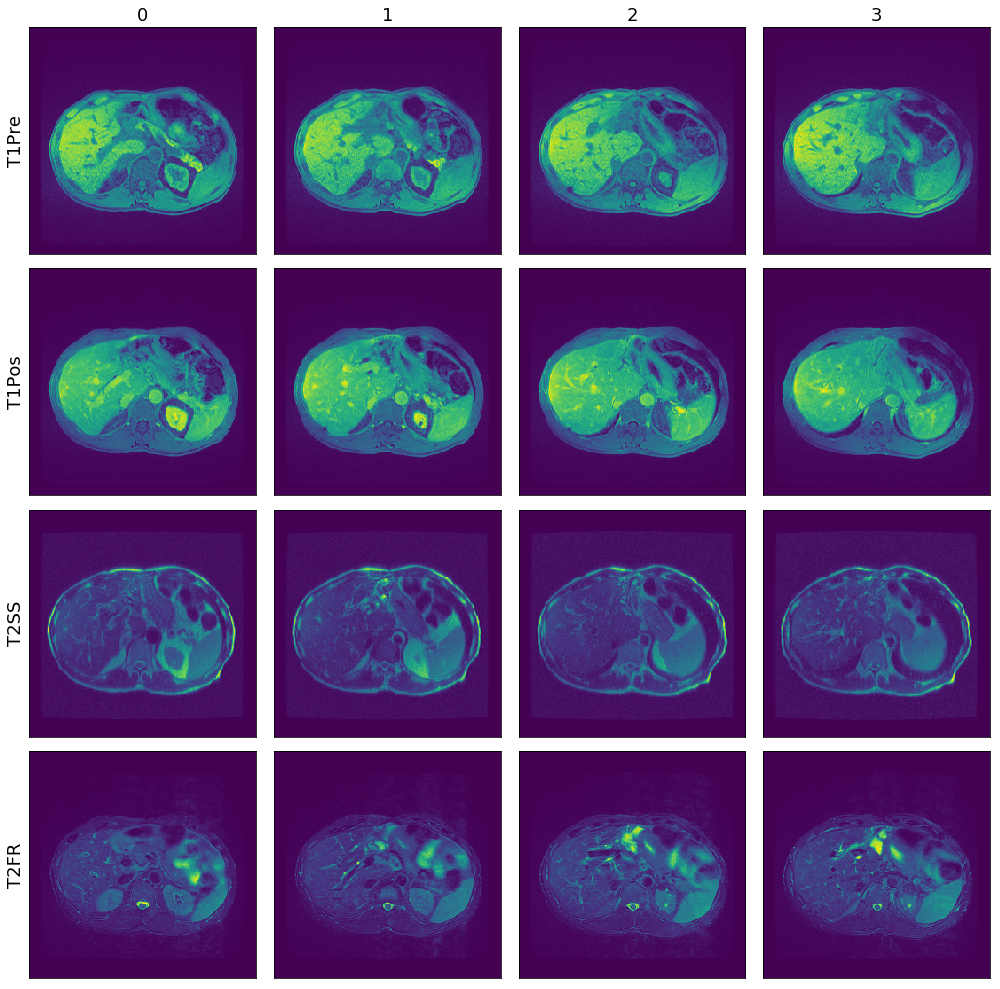

In [14]:

ds_single = ds.sel(sequence=['T1Pre','T1Pos','T2SS','T2FR'], subject='386')
fig, axs = grid_plots(ds_single, 'sequence', 'z', title='')

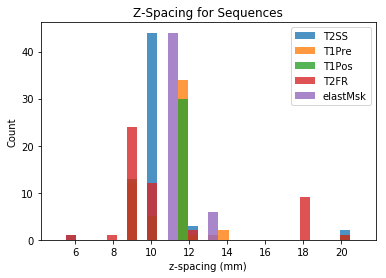

In [5]:
fig = plt.figure()
for i, seq in enumerate(sequence_labels[:-1]):
    ds.sel(sequence=seq).z_space.plot.hist(bins=30, range=(5,21), label=seq, alpha=0.8)
plt.xlabel('z-spacing (mm)')
plt.ylabel('Count')
plt.title('Z-Spacing for Sequences')
plt.legend()
plt.show()

Text(0,0.5,'Count')

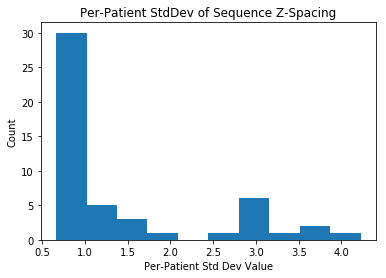

In [6]:
ds.z_space_std.plot.hist()
plt.title('Per-Patient StdDev of Sequence Z-Spacing')
plt.xlabel('Per-Patient Std Dev Value')
plt.ylabel('Count')

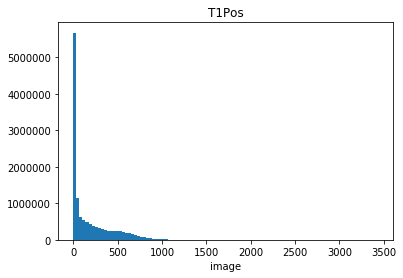

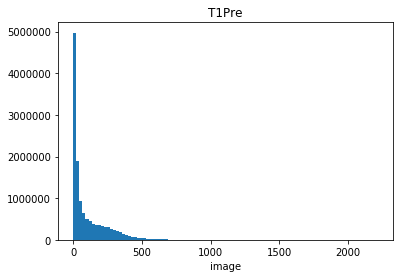

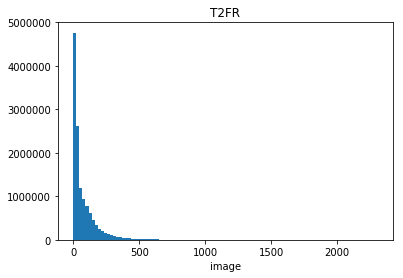

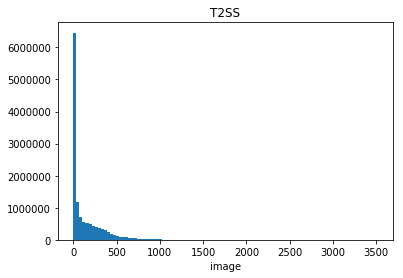

In [7]:
for seq in ['T1Pos', 'T1Pre', 'T2FR', 'T2SS']:
    plt.figure()
    _ = ds.image.sel(sequence=seq).plot.hist(bins=100)
    plt.title(seq)

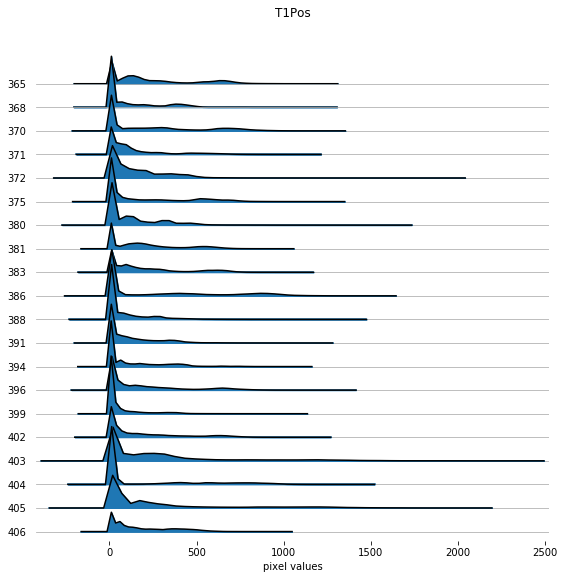

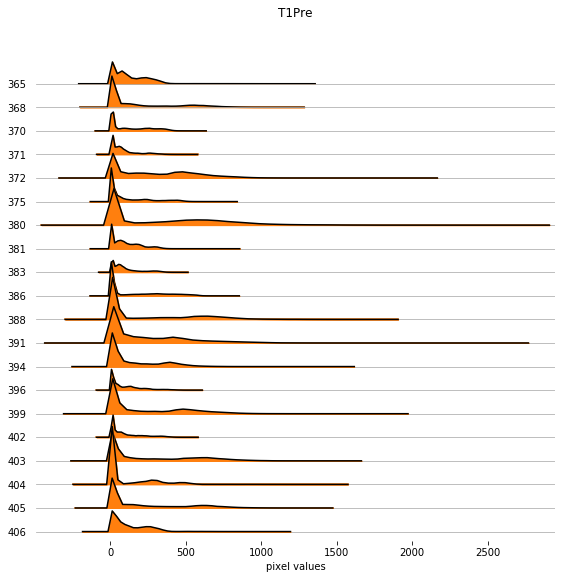

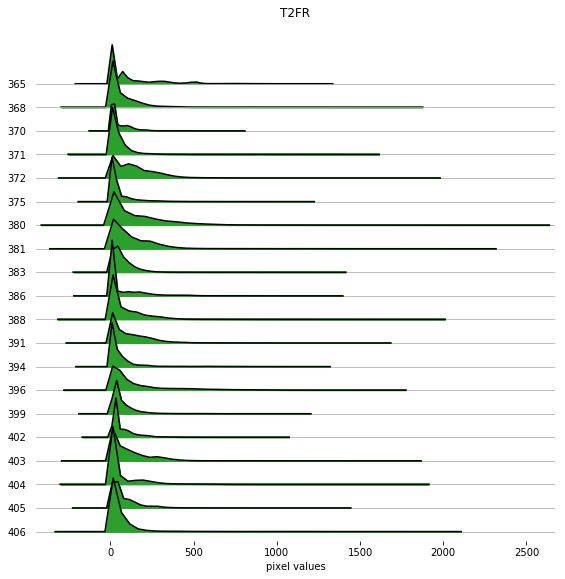

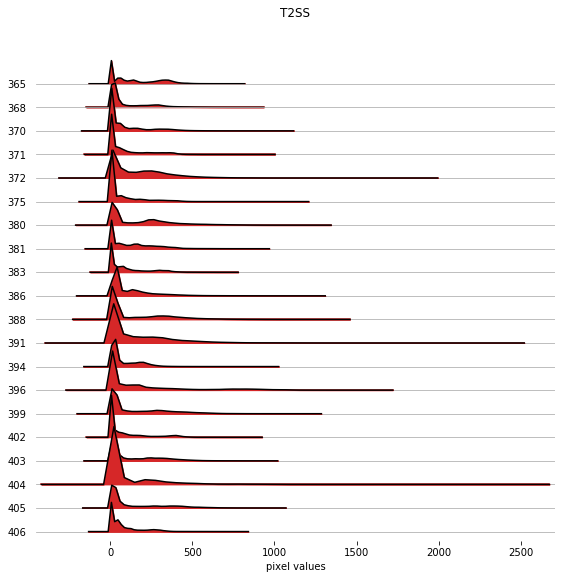

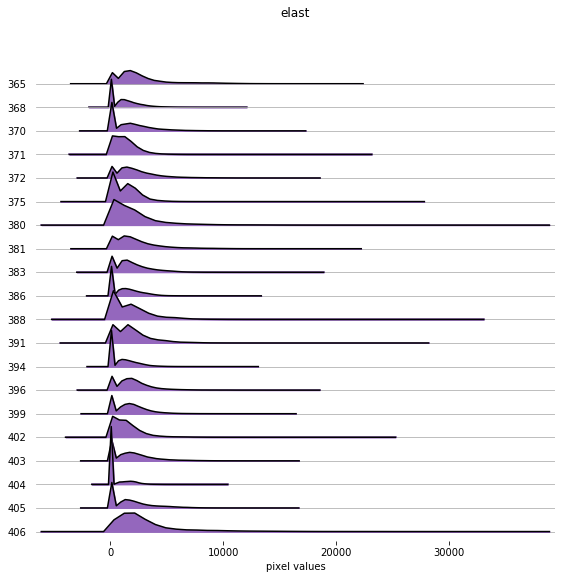

In [41]:
for i,col in enumerate(['T1Pos', 'T1Pre', 'T2FR', 'T2SS', 'elast']):
    fig, axes = joypy.joyplot(df, column=col, by='subject', range_style='own', kind='counts', bins=50,
                             title = col, color=f'C{i}', grid='y', figsize=(8,8))
    axes[-1].set_xlabel('pixel values')
    axes[-1].set_ylabel('subjects')
    plt.show()

In [1]:
df.describe()

NameError: name 'df' is not defined

/home/bpollack/conda_envs/mre/lib/python3.6/site-packages/xarray/plot/facetgrid.py:119: UserWarning: Ignoring col_wrap since both col and row were passed
  warnings.warn('Ignoring col_wrap since both col and row '


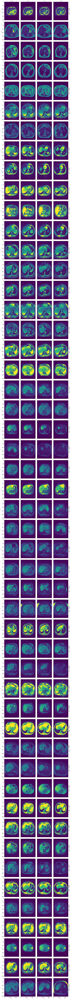

In [23]:
plot_args = {'size':3, 'robust':True, 'yincrease':False, 'add_colorbar':False, 'aspect':0.8, 'col_wrap':4}
ds.sel(sequence='T1Pre').image.plot(col='z', row='subject', **plot_args)

In [ ]:
ds_tmp = ds.sel(sequence='T2SS')
fig, axs = plt.subplots(len(ds.subject), 4, constrained_layout=True, figsize=(15,3*len(ds.subject)), sharex=True, sharey=True)
for i,subj in enumerate(ds.subject):
    ds_tmp_2 = ds_tmp.sel(subject=subj)
    for z in range(4):
        axs[i][z].imshow(ds_tmp_2.sel(z=z).image)
#axs = axs.flatten()
#axs[0].imshow(ds.sel(subject=subj, sequence='T1Pos', z=z).image)
#axs[1].imshow(ds.sel(subject=subj, sequence='elast', z=z).image)
#axs[2].imshow(ds.sel(subject=subj, sequence='elastMsk', z=z).image)